<a href="https://colab.research.google.com/github/MiguelAngel-ht/Image_Processing_/blob/main/Work_12__Morphological_Operations_/Notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Importing libreries 
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px

In [2]:
# To measure seconds o execution
from datetime import datetime

## Functions

In [18]:
# Function to scale a image from min to max

def ImScale(img, minf=0, maxf=255):

    x_min = img.min()
    x_max = img.max()

    return minf + ((img - x_min) / (x_max - x_min)) * (maxf - minf)

In [ ]:
# Add constant border of 0 en a matrix 
def constant_border(img):
  N, M = np.shape(img)
  img_out = np.zeros((N+2,M+2), np.uint8)
  img_out[1:N+1,1:M+1] = img
  return img_out

In [ ]:
# Simulation of function of Matlab 
def bwlabel(img):

  img_out = img
  x = 0
  y = 0
  label = 1
  N, M = np.shape(img_out)

  for i in range(N):
    for j in range(M):
      if img_out[i][j] == 255:
        
        for k in np.arange(j, M, 1):  #---->
          if img_out[i, k] == 255: 
            x += 1
          else:
            break                                    
                                      # |
        for k in np.arange(i, N, 1):  # v 
          if img_out[k, j] == 255:
            y += 1
          else:
            break

        img_out[i:i+y,j:j+x] = label
        label += 1
        x = 0 
        y = 0
        
  return img_out      

In [ ]:
# Reducted version of first function
def bwlabel2(img):

  img.astype('uint8')
  label = 1
  N, M = np.shape(img)

  for i in range(N):
    for j in range(M):

      if img[i][j] == 255:

        x = np.argmin(img[i,j:j+150])                            
        y = np.argmin(img[i:i+150,j])

        img[i:i+y,j:j+x] = label
        label += 1
        
  return img  

In [ ]:
# Obtaining vertices and center of rectangles
def bwhitmiss(img):

  vertices, centers = [], []
  N, M = np.shape(img)

  for i in range(10):
    for j in range(M):
      if img[i][j] != 0:
 
        x = np.argmin(img[i,j:])                            
        y = np.argmin(img[i:,j])
        print(img[i:i+y,j:j+x])
        img[i:i+y,j:j+x] = 0
        img[i,j] =  255
        img[i,j+x-1] =  255
        img[i+y-1,j] =  255
        img[i+y-1,j+x-1] = 255
        print(img[i:i+y,j:j+x])
        vertices.append([(i,j), (i,j+x), (i+y,j), (i+y,j+x)])
        centers.append((i + y//2, j + x//2))
        
  return img, vertices, centers 

# Code

## **Characters Counting**

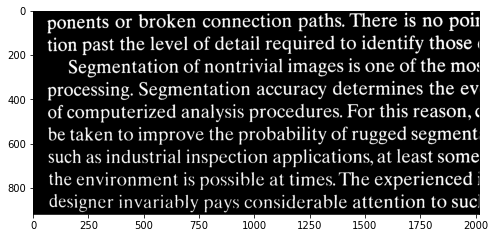

In [3]:
img = cv.imread('Fig1022(a).tif', 0)
plt.figure(figsize=(8,12))
plt.imshow(img, 'gray')
plt.show()

In [4]:
kernel = np.ones((3,3))
img_op = cv.dilate(img, kernel)

In [5]:
fig = px.imshow(img_op, color_continuous_scale='gray')
fig.show()

In [6]:
kernel = np.ones((4, 4))
img_op2 = cv.dilate(img, kernel)
img_op[700:,:] = img_op2[700:,:]

In [7]:
fig = px.imshow(img_op, color_continuous_scale='gray')
fig.show()

In [8]:
kernel = np.ones((1,5))
opening = cv.morphologyEx(img_op, cv.MORPH_OPEN, kernel)

In [9]:
fig = px.imshow(opening, color_continuous_scale='gray')
fig.show()

In [10]:
text = """ponents or broken connection paths There is no poition past the level of detail required to identify those Segmentation of nontrivial images is one of the mo processing Segmentation accuracy determines the ev of computerized analysis procedures For this reason be taken to improve the probability of rugged segment such as industrial inspection applications at least some the environment is possible at times The experienced designer invariably pays considerable attention to suc"""
len(text.replace(' ', ''))

408

In [11]:
img_lab = cv.connectedComponentsWithStats(opening, cv.CV_32S)

In [12]:
img_lab[0]

472

In [13]:
img_labed = img_lab[1]

In [14]:
n, m = np.shape(img_labed)

for i  in range(img_lab[0]):
  if img_lab[2][i][-1] < 350:
    img_labed[img_labed == i] = 0

for i in range(n):
  label = img_labed[i, m-1]
  if label != 0:
    img_labed[img_labed == label] = 0

img_labed[img_labed != 0] = 255
img_labed = img_labed.astype('uint8')
cv.imwrite('letters_clear.png', img_labed)

True

In [15]:
output = cv.connectedComponentsWithStats(img_labed, cv.CV_32S)
(num_lab, img_lab, stats, centroids) = output

In [16]:
num_lab

408

In [17]:
fig = px.imshow(img_lab, color_continuous_scale='gray')
fig.show()

## **Rectangle Caracteristics**

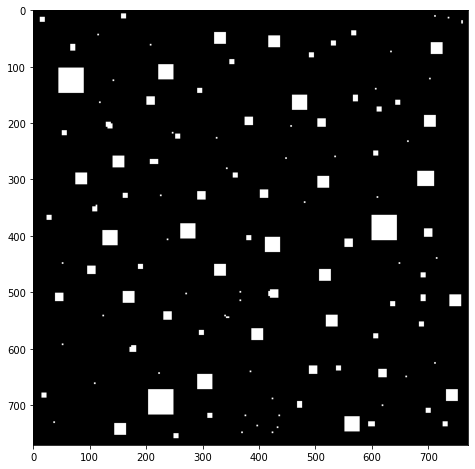

In [19]:
img2 = cv.imread('Fig1013(a).tif', 0)
plt.figure(figsize=(8,8))
plt.imshow(img2, 'gray')
plt.show()

In [20]:
# start_time = datetime.now()

# img2_label = bwlabel(img2)

# end_time = datetime.now()
# print('Duration: {}'.format(end_time - start_time))

In [21]:
# start_time = datetime.now()

# img2_label = bwlabel2(img2)

# end_time = datetime.now()
# print('Duration: {}'.format(end_time - start_time))

In [22]:
start_time = datetime.now()

(n_lab, img2_label, stats, centroids) = cv.connectedComponentsWithStats(img2,
                                                                        cv.CV_32S)

end_time = datetime.now()
print('Duration: {}'.format(end_time - start_time))

Duration: 0:00:00.006279


In [23]:
img2_label = ImScale(img2_label)
fig = px.imshow(img2_label, color_continuous_scale='gray')
fig.show()

In [29]:
print('Num \t Center \t Area \t    Vertices')
for i in range(n_lab-1):
  print(i,'\t', np.round(centroids[i+1],1),'\t', stats[i+1][-1],'\t',
        stats[i+1][0:2],
        stats[i+1][0:2] + [stats[i+1][2],0],
        stats[i+1][0:2] + [0, stats[i+1][3]],
        stats[i+1][0:2] + [stats[i+1][2], stats[i+1][3]]
        )

Num 	 Center 	 Area 	    Vertices
0  &  [160.  10.]  &  81  &  [156   6] [165   6] [156  15] [165  15]  \\ 
1  &  [712.  10.]  &  9  &  [711   9] [714   9] [711  12] [714  12]  \\ 
2  &  [16. 16.]  &  81  &  [12 12] [21 12] [12 21] [21 21]  \\ 
3  &  [736.  13.]  &  9  &  [735  12] [738  12] [735  15] [738  15]  \\ 
4  &  [760.   20.5]  &  18  &  [759  18] [762  18] [759  24] [762  24]  \\ 
5  &  [568.  40.]  &  81  &  [564  36] [573  36] [564  45] [573  45]  \\ 
6  &  [331.  49.]  &  441  &  [321  39] [342  39] [321  60] [342  60]  \\ 
7  &  [115.  43.]  &  9  &  [114  42] [117  42] [114  45] [117  45]  \\ 
8  &  [427.  55.]  &  441  &  [417  45] [438  45] [417  66] [438  66]  \\ 
9  &  [532.  58.]  &  81  &  [528  54] [537  54] [528  63] [537  63]  \\ 
10  &  [715.  67.]  &  441  &  [705  57] [726  57] [705  78] [726  78]  \\ 
11  &  [70.  65.5]  &  108  &  [66 60] [75 60] [66 72] [75 72]  \\ 
12  &  [208.  61.]  &  9  &  [207  60] [210  60] [207  63] [210  63]  \\ 
13  &  [634.  73.

# Segmentación

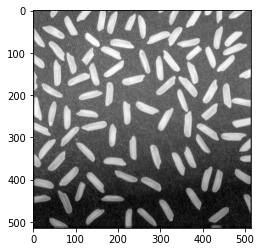

In [30]:
img3 = cv.imread('Fig1026(a).tif', 0)
plt.imshow(img3, 'gray')
plt.show()

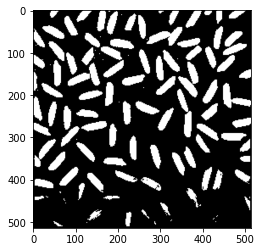

In [31]:
img3_umb_1 = cv.threshold(img3, 135, 245, cv.THRESH_BINARY)[1]
plt.imshow(img3_umb_1, 'gray')
plt.show()

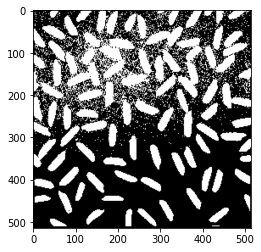

In [32]:
img3_umb_2 = cv.threshold(img3, 110, 240, cv.THRESH_BINARY)[1]
plt.imshow(img3_umb_2, 'gray')
plt.show()

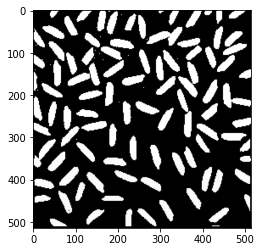

In [34]:
img3_umb_1[350:,:] = img3_umb_2[350:,:] 
plt.imshow(img3_umb_1, 'gray')
plt.show()

In [35]:
kernel = np.ones((3,3),np.uint8)
opening = cv.morphologyEx(img3_umb_1, cv.MORPH_OPEN, kernel)

In [36]:
# SCALING IN 0 AND 255 VALUES
thresh_image = cv.threshold(opening, 0, 255, cv.THRESH_BINARY)[1]
np.unique(thresh_image)

array([  0, 255], dtype=uint8)

In [37]:
fig = px.imshow(thresh_image, color_continuous_scale='gray')
fig.show()

In [38]:
# apply connected component analysis to the thresholded image
output = cv.connectedComponentsWithStats(thresh_image, cv.CV_32S)
(numLabels, labels, stats, centroids) = output

In [39]:
numLabels

95

In [47]:
labels = ImScale(labels)
fig = px.imshow(labels, color_continuous_scale='gray')
fig.show()

In [41]:
mask = labels.astype('bool')
intens = mask * img3

In [42]:
intensities = []
mean_intens = np.zeros(np.shape(labels))

# Loop of every label to obtain intensities of original image to measure 
# mean and set in other images
for i in range(numLabels-1):
  locs = np.where(labels == i+1)
  pixels = intens[locs]
  mean = np.mean(pixels)
  intensities.append(mean)
  mean_intens[locs] = mean

In [43]:
fig = px.imshow(intens, color_continuous_scale='gray')
fig.show()

In [44]:
cv.imwrite('celulas_intensidades_medias.png', mean_intens)
fig = px.imshow(mean_intens, color_continuous_scale='gray')
fig.show()

In [48]:
print('Num \t Center \t Area \t Intensidad Media')
for i in range(numLabels-1):
  print(i,'\t', np.round(centroids[i+1],1),'\t',
        stats[i+1][-1],'\t', intensities[i].round(2))

Num 	 Center 	 Area 	 Intensidad Media
0 	 [48.1  7.3] 	 240 	 169.57
1 	 [118.8  11.7] 	 516 	 179.6
2 	 [161.3  24.1] 	 756 	 184.79
3 	 [179.5   1.5] 	 16 	 146.0
4 	 [300.8   2.7] 	 72 	 164.28
5 	 [330.4  14.8] 	 476 	 176.27
6 	 [378.3  19.8] 	 756 	 186.88
7 	 [412.1   5.1] 	 180 	 180.44
8 	 [438.3  13.3] 	 372 	 177.89
9 	 [478.9   8.8] 	 484 	 175.69
10 	 [186.2  29.9] 	 812 	 181.51
11 	 [229.4  29.8] 	 568 	 183.2
12 	 [256.7  39.2] 	 744 	 185.19
13 	 [87.8 38.1] 	 776 	 182.72
14 	 [49.  51.2] 	 852 	 178.36
15 	 [435.8  65. ] 	 772 	 181.58
16 	 [313.5  62.1] 	 1668 	 185.96
17 	 [12.1 68.9] 	 576 	 175.74
18 	 [471.   66.2] 	 772 	 186.26
19 	 [139.2  70.6] 	 636 	 190.47
20 	 [368.2  77. ] 	 744 	 182.15
21 	 [208.6  79.2] 	 924 	 185.5
22 	 [56.9 95.3] 	 820 	 180.26
23 	 [474.8  91.4] 	 820 	 183.77
24 	 [378.7 100.8] 	 612 	 186.86
25 	 [185.   99.9] 	 828 	 188.12
26 	 [418.8 110.3] 	 740 	 188.55
27 	 [130.2 109.6] 	 636 	 183.12
28 	 [262.7 120.9] 	 792 	 181.04


In [46]:
# REFERENCES

# https://docs.opencv.org/4.x/d9/d61/tutorial_py_morphological_ops.html
# https://docs.opencv.org/3.4/d3/dc0/group__imgproc__shape.html